# Voronoi cell 'pixelation'

The plan is to take an image and:

1. Work out a depth map of the image.
2. Segment the image into sections, then based on average depth of the section uniformly randomly sprinkle points in the area (more points for closer areas).
3. Compute the voronoi cells for each dot.
4. Sample the colour of the original image at each dot, colour the associated voronoi cell that colour.

In [1]:
import cv2
import torch
import matplotlib.pyplot as plt
import transformers
from PIL import Image
import numpy as np
import requests

In [2]:
# load the image
img = cv2.imread("test.jpg")

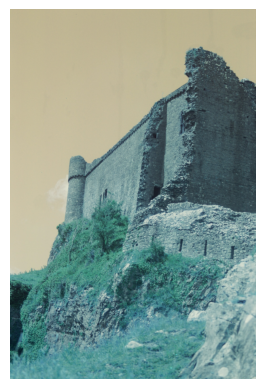

In [3]:
# show image
plt.axis("off")
plt.imshow(img)

In [4]:
img = Image.open("test.jpg")

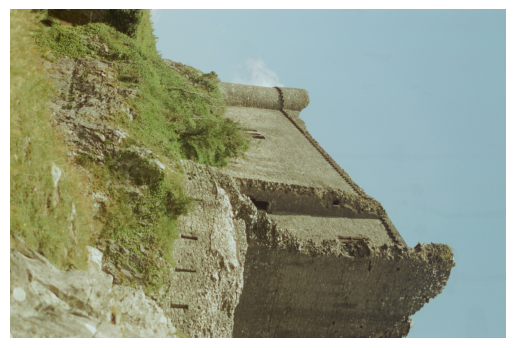

In [5]:
plt.axis("off")
plt.imshow(img)

In [6]:
# load model, do the small one for now
model = transformers.DPTForDepthEstimation.from_pretrained(
    "Intel/dpt-hybrid-midas", low_cpu_mem_usage=True
)

In [8]:
feature_extractor = transformers.DPTImageProcessor.from_pretrained(
    "Intel/dpt-hybrid-midas"
)

In [9]:
# preprocess image
inputs = feature_extractor(images=img, return_tensors="pt")

In [10]:
with torch.no_grad():
    outputs = model(**inputs)
    predicted_depth = outputs.predicted_depth

In [11]:
# interpolate to original size
prediction = torch.nn.functional.interpolate(
    predicted_depth.unsqueeze(1),
    size=img.size[::-1],
    mode="bicubic",
    align_corners=False,
)

In [12]:
# visualise prediction
output = prediction.squeeze().cpu().numpy()
formatted = (output * 255 / np.max(output)).astype("uint8")
depth = Image.fromarray(formatted)
depth.show()

In [13]:
predicted_depth.shape

torch.Size([1, 384, 384])

In [14]:
prediction.shape

torch.Size([1, 1, 2075, 3130])

Lets try it again with a different image with a little more going on

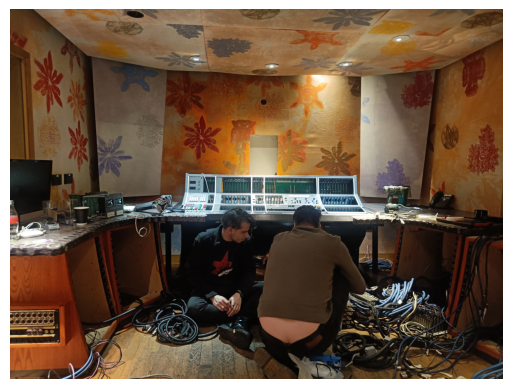

In [15]:
img2 = Image.open("sr4.jpg")
plt.axis("off")
plt.imshow(img2)

In [16]:
inputs = feature_extractor(images=img2, return_tensors="pt")
with torch.no_grad():
    outputs = model(**inputs)
    predicted_depth = outputs.predicted_depth

In [17]:
# interpolate to original size
prediction = torch.nn.functional.interpolate(
    predicted_depth.unsqueeze(1),
    size=img2.size[::-1],
    mode="bicubic",
    align_corners=False,
)

In [18]:
# visualise prediction
output = prediction.squeeze().cpu().numpy()
formatted = (output * 255 / np.max(output)).astype("uint8")
depth = Image.fromarray(formatted)
depth.show()

## So now to sprinkle and voronoi

Ok, so now the depth estimation works we can now use it to sprinkle points in the frame based on depth. We have a tensor with depth values for each pixel, so if we choose a box size we can use an averaging convolutional layer to work out the average depth for that region, then sprinkle points based on that value into a plane.

In [19]:
from scipy.spatial import Voronoi, voronoi_plot_2d
import matplotlib as mpl
import matplotlib.cm as cm
import cv2
import torch
import matplotlib.pyplot as plt
import transformers
from PIL import Image
import numpy as np

In [20]:
n = 10000
xy_min = [0, 0]
xy_max = [10, 20]
data = np.random.uniform(size=(n, 2))

In [21]:
vor = Voronoi(data)

(-0.04996793816658364,
 1.0499770663458332,
 -0.04996956844134547,
 1.0498646960986495)

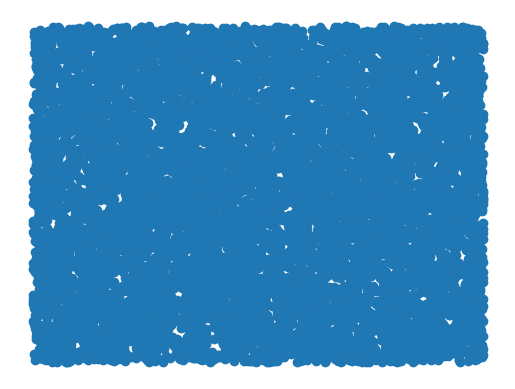

In [22]:
plt.scatter(data.T[0], data.T[1])
plt.axis("off")

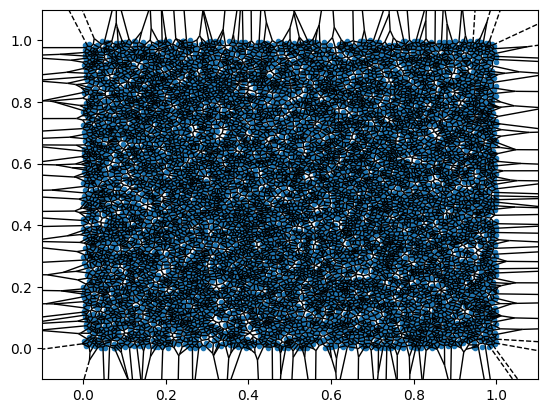

In [23]:
fig = voronoi_plot_2d(vor, show_points=True, show_vertices=False)
# plt.axis("off")

Ok, so what about colouring in the cells? Let's start with randomly picked colours I guess?

In [24]:
col_vals = np.random.uniform(low=0.0, high=5.0, size=n)

In [25]:
minima = min(col_vals)
maxima = max(col_vals)

In [26]:
norm = mpl.colors.Normalize(vmin=minima, vmax=maxima, clip=True)
mapper = cm.ScalarMappable(norm=norm, cmap=cm.viridis)

(0.0, 1.0)

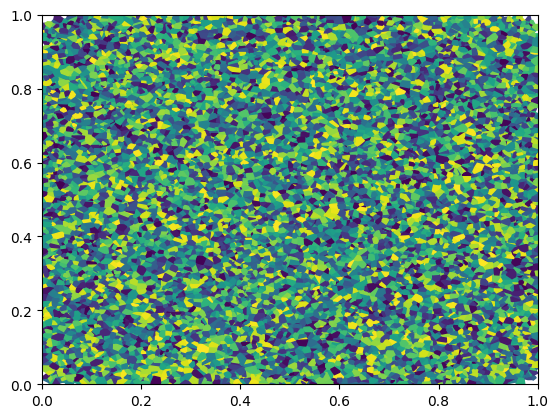

In [27]:
for r in range(len(vor.point_region)):
    region = vor.regions[vor.point_region[r]]
    if not -1 in region:
        polygon = [vor.vertices[i] for i in region]
        # print(polygon)
        plt.fill(*zip(*polygon), color=mapper.to_rgba(col_vals[r]))
plt.ylim(0, 1)
plt.xlim(0, 1)
# plt.axis("off")

### So how do we now get it to uniformly randomly sprinkle within the bounds we want?

Well, we split up the image into a set number of boxes, then we can use a averaging convolution to work out the average depth in each square, with more points being sprinkled there if there is less depth. From this we then simply create the coloured voronoi image. The follow up question is how to get the colour at each point?

In [28]:
prediction.shape

torch.Size([1, 1, 3072, 4096])

In [29]:
avg_depth = torch.nn.functional.avg_pool2d(prediction, 120)

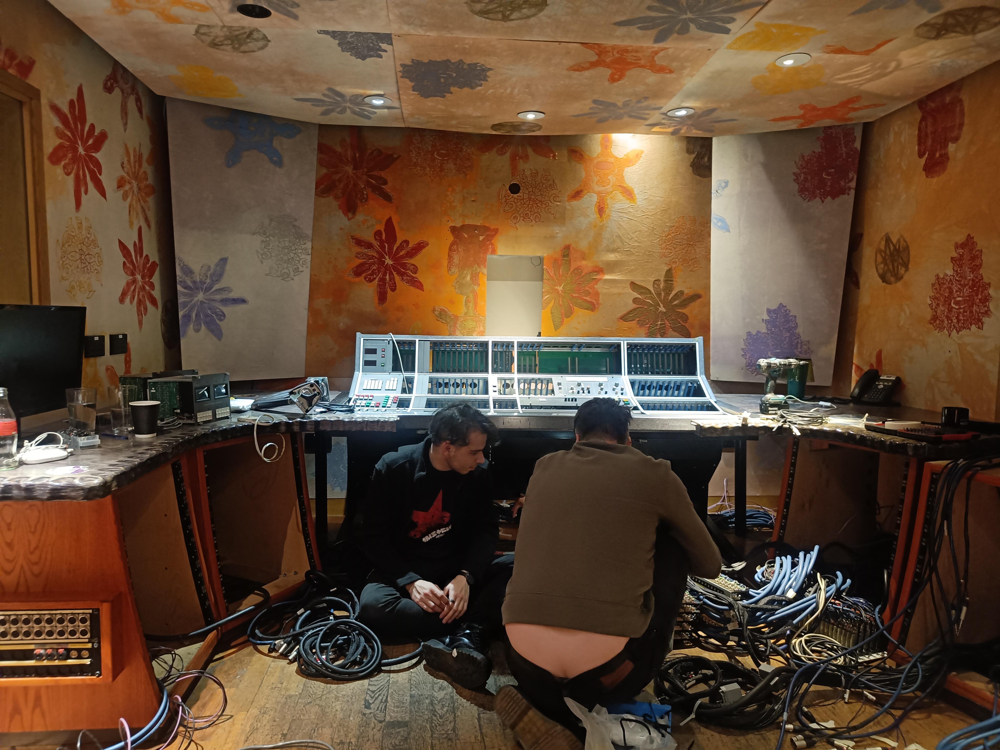

In [30]:
img2

(-0.5, 4095.5, 3071.5, -0.5)

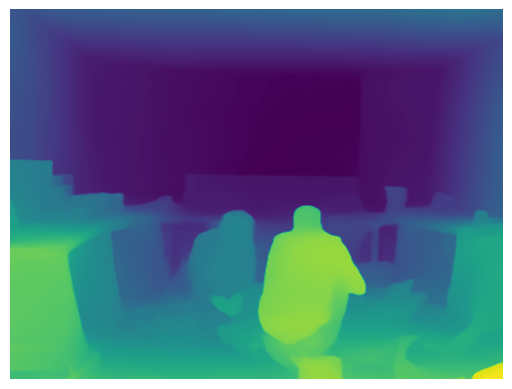

In [31]:
plt.imshow(prediction[0][0])
plt.axis("off")

In [32]:
filter_size = 200
avg_depth = torch.nn.functional.avg_pool2d(prediction, filter_size)

(-0.5, 19.5, 14.5, -0.5)

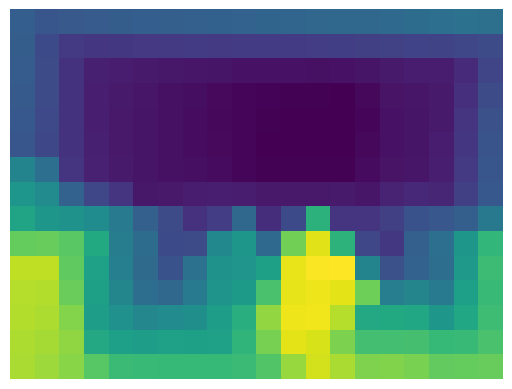

In [33]:
plt.imshow(avg_depth[0][0])
plt.axis("off")

In [34]:
avgs = avg_depth[0][0]
avgs

tensor([[ 534.5029,  491.4882,  509.6953,  521.7573,  530.0859,  536.9968,
          541.9163,  546.4069,  551.7888,  561.0731,  570.6299,  578.4180,
          584.9568,  589.5181,  594.9724,  602.1207,  620.3264,  637.2795,
          646.5333,  640.4167],
        [ 531.0925,  427.1635,  341.6440,  323.6732,  331.8513,  339.0055,
          344.7258,  346.2717,  344.9048,  346.0957,  352.4789,  356.4895,
          359.3556,  363.8953,  370.3685,  377.9489,  390.7986,  397.5734,
          404.5450,  432.5492],
        [ 523.0580,  429.7415,  307.3048,  218.7424,  202.8468,  193.6448,
          184.5549,  177.3835,  168.8328,  162.3795,  160.7733,  156.9805,
          155.3296,  157.1194,  171.9975,  193.5672,  202.3414,  209.7145,
          271.9739,  402.3294],
        [ 512.2020,  429.2082,  306.7671,  212.4700,  194.6833,  177.2438,
          156.1884,  139.8588,  125.5580,  112.9260,  101.2210,   94.5851,
           93.2511,   91.4807,  118.5801,  167.8944,  179.8260,  193.9747,
    

In [35]:
avg_min, _ = torch.min(avgs, dim=1, keepdim=True)
avg_max, _ = torch.max(avgs, dim=1, keepdim=True)

In [36]:
norm_avg = (avgs - avg_min) / (avg_max - avg_min)

In [37]:
norm_avg

tensor([[2.7743e-01, 0.0000e+00, 1.1743e-01, 1.9523e-01, 2.4895e-01, 2.9352e-01,
         3.2525e-01, 3.5421e-01, 3.8892e-01, 4.4880e-01, 5.1044e-01, 5.6067e-01,
         6.0285e-01, 6.3227e-01, 6.6745e-01, 7.1355e-01, 8.3097e-01, 9.4032e-01,
         1.0000e+00, 9.6055e-01],
        [1.0000e+00, 4.9894e-01, 8.6640e-02, 0.0000e+00, 3.9428e-02, 7.3919e-02,
         1.0150e-01, 1.0895e-01, 1.0236e-01, 1.0810e-01, 1.3888e-01, 1.5821e-01,
         1.7203e-01, 1.9392e-01, 2.2512e-01, 2.6167e-01, 3.2362e-01, 3.5628e-01,
         3.8989e-01, 5.2491e-01],
        [1.0000e+00, 7.4624e-01, 4.1328e-01, 1.7244e-01, 1.2922e-01, 1.0419e-01,
         7.9475e-02, 5.9973e-02, 3.6721e-02, 1.9172e-02, 1.4804e-02, 4.4894e-03,
         0.0000e+00, 4.8673e-03, 4.5327e-02, 1.0398e-01, 1.2784e-01, 1.4789e-01,
         3.1720e-01, 6.7169e-01],
        [1.0000e+00, 8.0273e-01, 5.1171e-01, 2.8758e-01, 2.4530e-01, 2.0385e-01,
         1.5380e-01, 1.1499e-01, 8.0997e-02, 5.0973e-02, 2.3151e-02, 7.3786e-03,
       

(-0.5, 19.5, 14.5, -0.5)

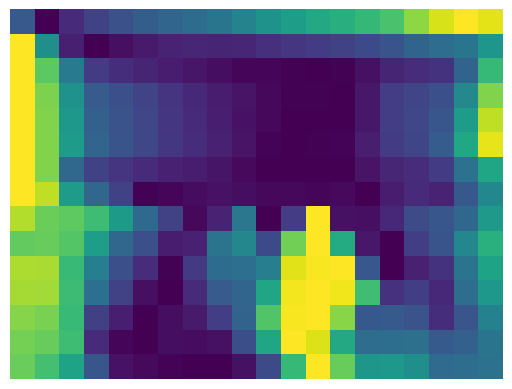

In [38]:
plt.imshow(norm_avg)
plt.axis("off")

Ok, so now I need to find a good function for taking this value and turning it into number for how many points should sampled, or more specifically it probably makes sense to uniformly randomly pick a number between a range defined by this and then sprinkle that many points, so for the most distant regions start at zero so there is a chance than nothing gets sampled there

So two curves, both exponential/polynomial in shape, that give the lower and upper limits.

In [39]:
x = np.linspace(0, 1, 1000)

In [40]:
def f_1(x, N):
    return (N + 1) ** x - 1

In [41]:
def f_2(x, N):
    return (19 * N / 20) * x**2 + (N / 20) * x

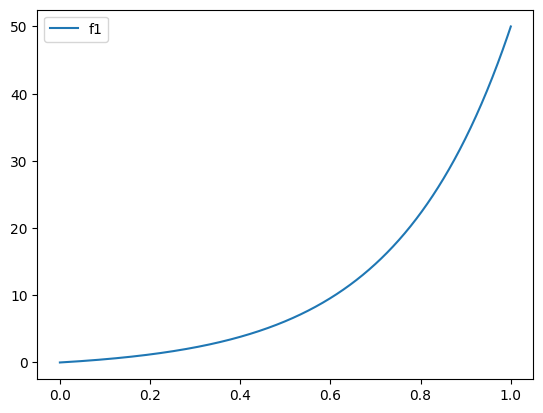

In [42]:
plt.plot(x, f_1(x, 50), label="f1")
# plt.plot(x, f_2(x, 50), label="f2")
plt.legend()

Ok, so simplifying to just picking a number to sample by:

In [43]:
def pick_points_number(depth, max_points):
    return np.around((max_points + 1) ** depth - 1).astype(int)

In [702]:
pick_points_number(0.1, 1000)

1

so now to randomly sprinkle into boxes based on this:

In [49]:
img2.size

(4096, 3072)

In [50]:
norm_avg.shape

torch.Size([15, 20])

In [51]:
img2.size[0] / norm_avg.shape[0]

273.06666666666666

In [52]:
img2.size[1] / norm_avg.shape[1]

153.6

In [53]:
n = 10
xy_min = [0, 0]
xy_max = [10, 20]
data = np.random.uniform(size=(n, 2))

In [54]:
data

array([[0.66895792, 0.56236066],
       [0.62954811, 0.7941593 ],
       [0.69050617, 0.39006442],
       [0.3773092 , 0.8612717 ],
       [0.35460859, 0.7308706 ],
       [0.56295506, 0.61332758],
       [0.21381721, 0.74627237],
       [0.52270078, 0.54807879],
       [0.64680466, 0.4846581 ],
       [0.64730086, 0.17805982]])

Max points should be based on a standard pixelisation/bit reduction rate:

\begin{equation}
    \gamma = \frac{m^2}{n^2}
\end{equation}

where $ n^2 $ is the number of pixels in a block from the original resolution and $ m^2 $ is the targe pixel number. Then for a sampled block of $ r*s $ pixels we have a max dots:

\begin{equation}
    \text{max dots} = r*s*\gamma
\end{equation}

where the size of $ r $ and $ s $ can be derived from the resolution of the original image (i.e. how good the depth estimator is going to be!). 

In [56]:
def compute_max_dots(bit_rate, pixels_square):
    """Compute the max dots value as notated above for a bit reduction goal"""
    return bit_rate * pixels_square

In [59]:
pick_points_number(1, compute_max_dots(0.5, 200))

100

ok so lets just try a pipeline from scratch, first off a picture:

In [249]:
from sklearn import preprocessing
from scipy.spatial import Voronoi, voronoi_plot_2d
import matplotlib as mpl
import matplotlib.cm as cm
import cv2
import torch
import matplotlib.pyplot as plt
import transformers
from PIL import Image
import numpy as np

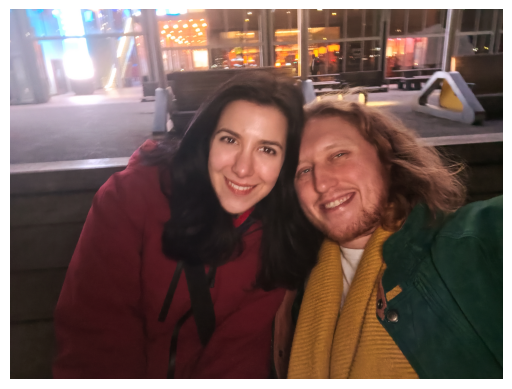

In [250]:
img = Image.open("test_4.jpg")
plt.axis("off")
plt.imshow(img)

Extract the depth plot

In [251]:
inputs = feature_extractor(images=img, return_tensors="pt")
with torch.no_grad():
    outputs = model(**inputs)
    predicted_depth = outputs.predicted_depth

In [252]:
# interpolate to original size
prediction = torch.nn.functional.interpolate(
    predicted_depth.unsqueeze(1),
    size=img2.size[::-1],
    mode="bicubic",
    align_corners=False,
)

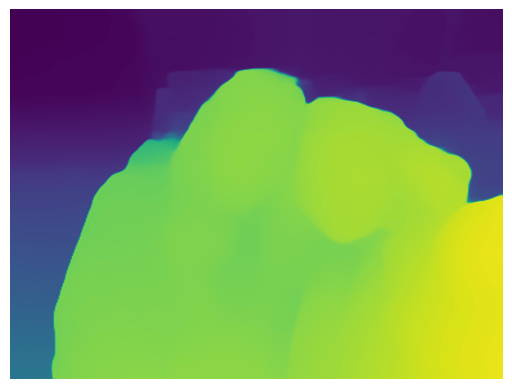

In [253]:
# visualise prediction
output = prediction.squeeze().cpu().numpy()
formatted = (output * 255 / np.max(output)).astype("uint8")
depth = Image.fromarray(formatted)
plt.axis("off")
plt.imshow(depth)
# depth.show()

Ok, so now for splitting it up, averaging and normalising.

(-0.5, 39.5, 29.5, -0.5)

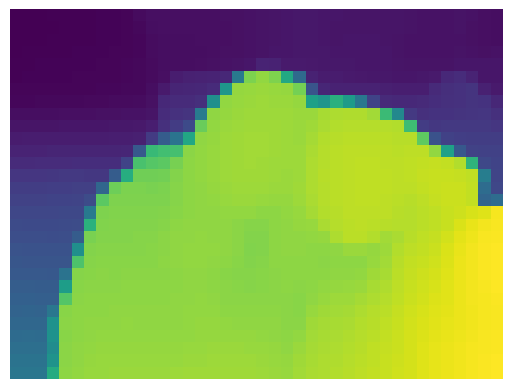

In [276]:
# averaging
filter_size = 100
avg_depth = torch.nn.functional.avg_pool2d(prediction, filter_size)
plt.imshow(avg_depth[0][0])
plt.axis("off")

In [277]:
avgs = avg_depth[0][0]
min_max_scaler = preprocessing.MinMaxScaler()
norm_avg = min_max_scaler.fit_transform(avgs)

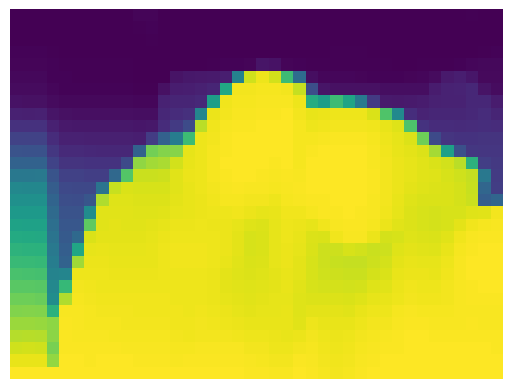

In [278]:
plt.axis("off")
plt.imshow(norm_avg)

In [312]:
norm_avg.shape

(30, 40)

Now to randomly sprinkle the points:

In [279]:
def pick_points_number(depth, max_points):
    return np.around((max_points + 1) ** depth - 1).astype(int)


def compute_max_dots(bit_rate, pixels_square):
    """Compute the max dots value as notated above for a bit reduction goal"""
    return bit_rate * pixels_square

In [280]:
def scatter_points(n_points, xy_min, xy_max):
    return np.random.uniform(xy_min, xy_max, size=(n_points, 2))

In [442]:
bit_rate = 0.25
pixels_square = 200
max_dots = compute_max_dots(bit_rate, pixels_square)
points = []
max_y_squares = norm_avg.shape[0]
max_x_squares = norm_avg.shape[1]

for i in range(norm_avg.shape[0]):
    for j in range(norm_avg.shape[1]):
        xy_min = [pixels_square * j, pixels_square * (max_y_squares - i - 1)]
        xy_max = [pixels_square * (j + 1), pixels_square * (max_y_squares - i)]
        points.append(
            scatter_points(
                pick_points_number(float(norm_avg[i, j]), max_dots),
                xy_min=xy_min,
                xy_max=xy_max,
            )
        )

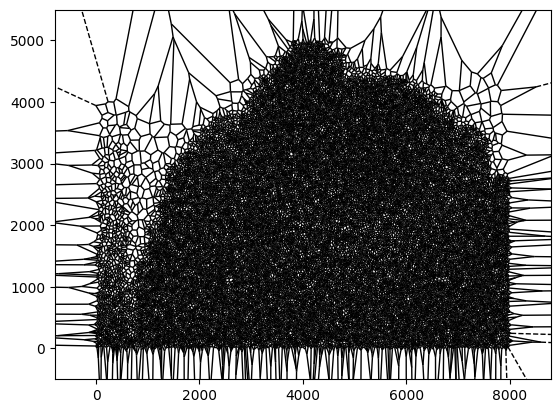

In [443]:
all_points = np.concatenate(points)
vor = Voronoi(all_points)
fig = voronoi_plot_2d(vor, show_points=False, show_vertices=False)

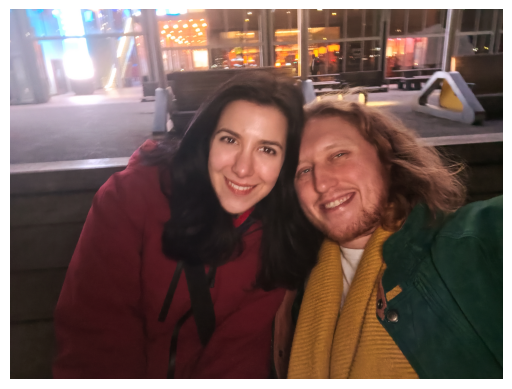

In [261]:
plt.axis("off")
plt.imshow(img)

Ok, so lets turn what the pipline is so far into a single function:

In [304]:
# load model, do the small one for now
model = transformers.DPTForDepthEstimation.from_pretrained(
    "Intel/dpt-hybrid-midas", low_cpu_mem_usage=True
)
feature_extractor = transformers.DPTImageProcessor.from_pretrained(
    "Intel/dpt-hybrid-midas"
)


def pick_points_number(depth, max_points):
    return np.around((max_points + 1) ** depth - 1).astype(int)


def compute_max_dots(bit_rate, pixels_square):
    """Compute the max dots value as notated above for a bit reduction goal"""
    return bit_rate * pixels_square


def scatter_points(n_points, xy_min, xy_max):
    return np.random.uniform(xy_min, xy_max, size=(n_points, 2))


def voronoi_pixels(
    img_name: str, filter_size: int, bit_rate: float, show_steps: bool = False
):

    # Remove axes for showing steps
    if show_steps:
        plt.axis("off")

    # Load image
    img = Image.open(img_name)
    if show_steps:
        print("Original image:")
        plt.imshow(img)

    # Extract depth plot
    inputs = feature_extractor(images=img, return_tensors="pt")
    with torch.no_grad():
        outputs = model(**inputs)
        predicted_depth = outputs.predicted_depth

    # interpolate to original size
    prediction = torch.nn.functional.interpolate(
        predicted_depth.unsqueeze(1),
        size=img2.size[::-1],
        mode="bicubic",
        align_corners=False,
    )

    # visualise prediction
    if show_steps:
        print("Predicted depth map:")
        output = prediction.squeeze().cpu().numpy()
        formatted = (output * 255 / np.max(output)).astype("uint8")
        depth = Image.fromarray(formatted)
        plt.imshow(depth)

    # Filter image, avg pooling
    avg_depth = torch.nn.functional.avg_pool2d(prediction, filter_size)
    if show_steps:
        print("Pooled depth:")
        plt.imshow(avg_depth[0][0])

    # Normalise
    avgs = avg_depth[0][0]
    min_max_scaler = preprocessing.MinMaxScaler()
    norm_avg = min_max_scaler.fit_transform(avgs)
    if show_steps:
        print("Normalised pooled depth:")
        plt.imshow(norm_avg)

    # Sample points for voronoi cells
    max_dots = compute_max_dots(bit_rate, filter_size)
    points = []
    max_y_squares = norm_avg.shape[0]
    for i in range(norm_avg.shape[0]):
        for j in range(norm_avg.shape[1]):
            xy_min = [filter_size * j, filter_size * (max_y_squares - i - 1)]
            xy_max = [filter_size * (j + 1), filter_size * (max_y_squares - i)]
            points.append(
                scatter_points(
                    pick_points_number(float(norm_avg[i, j]), max_dots),
                    xy_min=xy_min,
                    xy_max=xy_max,
                )
            )
    all_points = np.concatenate(points)

    # Create voronoi cells and plot
    vor = Voronoi(all_points)
    fig = voronoi_plot_2d(vor, show_points=False, show_vertices=False)

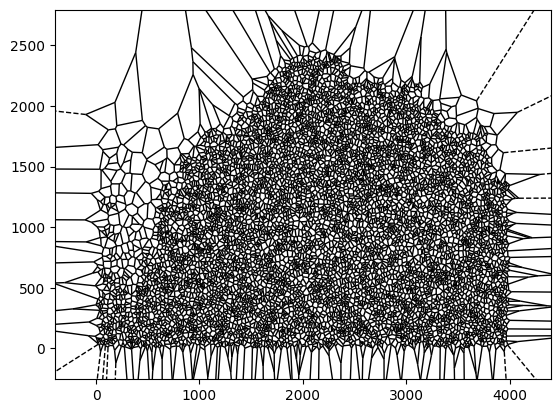

In [306]:
voronoi_pixels("test_4.jpg", filter_size=200, bit_rate=0.25)

### Picking colour from the points

So now I have the voronoi cell pixelisation generator, how do I sampler the colours at those points?

Well I have the original image, and I have the points, so I guess I just scale the points to fit the pixels of the original image, then grab the colour of that pixel (with some rounding the integer values of the points) to grab the colours.

In [444]:
# Lets start with the points:
all_points

array([[3672.72429819, 4886.25044081],
       [3780.03674201, 4842.13955917],
       [3768.64584686, 4952.76321233],
       ...,
       [7912.64562808,   36.18802174],
       [7973.36096491,  144.84177108],
       [7934.45342722,  195.28493707]])

In [445]:
norm_avg.shape

(30, 40)

In [446]:
np.max(all_points[:, 0])

7999.795290426334

In [447]:
np.max(all_points[:, 1])

4999.049537349978

In [448]:
img.size

(4096, 3072)

In [455]:
filter_size = 200
y_scaler = img.size[0] / (norm_avg.shape[1] * filter_size)
x_scaler = img.size[1] / (norm_avg.shape[0] * filter_size)

In [450]:
from copy import copy

In [456]:
scaled_points = copy(all_points)
scaled_points[:, 0] = scaled_points[:, 0] * (
    img.size[0] / (norm_avg.shape[1] * filter_size)
)
scaled_points[:, 1] = scaled_points[:, 1] * (
    img.size[1] / (norm_avg.shape[0] * filter_size)
)

ok, now to extract the colours and feed it to the voronoi cell colouring thing

In [457]:
pix = img.load()

In [458]:
rgb = pix[0, 0]
(rgb[0] / 255, rgb[1] / 255, rgb[2] / 255)

(0.5254901960784314, 0.6745098039215687, 0.8509803921568627)

In [459]:
# norm = mpl.colors.Normalize(vmin=minima, vmax=maxima, clip=True)
# mapper = cm.ScalarMappable(norm=norm, cmap=cm.viridis)
len_scaled_points = len(scaled_points)
for r in range(len(vor.point_region)):
    region = vor.regions[vor.point_region[r]]
    if not -1 in region:
        polygon = [vor.vertices[i] for i in region]
        # print(polygon)
        # print(pix[scaled_points[r][0], scaled_points[r][1]])
        colour = pix[
            scaled_points[r][0],
            -scaled_points[r][1],
        ]
        plt.fill(
            *zip(*polygon), color=(colour[0] / 255, colour[1] / 255, colour[2] / 255)
        )
plt.axis("off")
plt.ylim(0, norm_avg.shape[0] * filter_size)
plt.xlim(0, norm_avg.shape[1] * filter_size)

IndexError: image index out of range

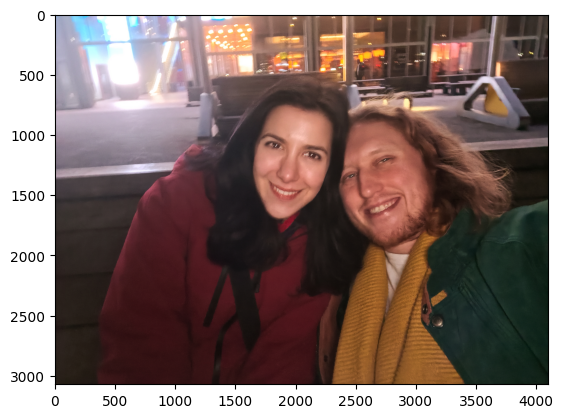

In [424]:
plt.imshow(img)

In [365]:
scaled_points = np.around(scaled_points).astype(int)

In [372]:
pix[scaled_points[4][0], scaled_points[4][1]]

(77, 22, 28)

Now for the full colouring pipeline:

In [1]:
from sklearn import preprocessing
from scipy.spatial import Voronoi, voronoi_plot_2d
import matplotlib as mpl
import matplotlib.cm as cm
import cv2
import torch
import matplotlib.pyplot as plt
import transformers
from PIL import Image
import numpy as np
from copy import copy

# load model, do the small one for now
model = transformers.DPTForDepthEstimation.from_pretrained(
    "Intel/dpt-hybrid-midas", low_cpu_mem_usage=True
)
feature_extractor = transformers.DPTImageProcessor.from_pretrained(
    "Intel/dpt-hybrid-midas"
)


def pick_points_number(depth, max_points):
    return np.around((max_points + 1) ** depth - 1).astype(int)


def compute_max_dots(bit_rate, pixels_square):
    """Compute the max dots value as notated above for a bit reduction goal"""
    return bit_rate * pixels_square


def scatter_points(n_points, xy_min, xy_max):
    return np.random.uniform(xy_min, xy_max, size=(n_points, 2))


def voronoi_pixels(
    img_name: str, filter_size: int, bit_rate: float, show_steps: bool = False
):

    # Remove axes for showing steps
    if show_steps:
        plt.axis("off")

    # Load image
    img = Image.open(img_name)
    if show_steps:
        print("Original image:")
        plt.imshow(img)

    # Extract depth plot
    inputs = feature_extractor(images=img, return_tensors="pt")
    with torch.no_grad():
        outputs = model(**inputs)
        predicted_depth = outputs.predicted_depth

    # interpolate to original size
    prediction = torch.nn.functional.interpolate(
        predicted_depth.unsqueeze(1),
        size=img.size[::-1],
        mode="bicubic",
        align_corners=False,
    )

    # visualise prediction
    if show_steps:
        print("Predicted depth map:")
        output = prediction.squeeze().cpu().numpy()
        formatted = (output * 255 / np.max(output)).astype("uint8")
        depth = Image.fromarray(formatted)
        plt.imshow(depth)

    # Filter image, avg pooling
    avg_depth = torch.nn.functional.avg_pool2d(prediction, filter_size)
    if show_steps:
        print("Pooled depth:")
        plt.imshow(avg_depth[0][0])

    # Normalise
    avgs = avg_depth[0][0]
    min_max_scaler = preprocessing.MinMaxScaler()
    norm_avg = min_max_scaler.fit_transform(avgs)
    if show_steps:
        print("Normalised pooled depth:")
        plt.imshow(norm_avg)

    # Sample points for voronoi cells
    max_dots = compute_max_dots(bit_rate, filter_size)
    points = []
    max_y_squares = norm_avg.shape[0]
    for i in range(norm_avg.shape[0]):
        for j in range(norm_avg.shape[1]):
            xy_min = [filter_size * j, filter_size * (max_y_squares - i - 1)]
            xy_max = [filter_size * (j + 1), filter_size * (max_y_squares - i)]
            points.append(
                scatter_points(
                    pick_points_number(float(norm_avg[i, j]), max_dots),
                    xy_min=xy_min,
                    xy_max=xy_max,
                )
            )
    all_points = np.concatenate(points)

    # Create voronoi cells and plot
    vor = Voronoi(all_points)
    if show_steps:
        print("voronoi figure:")
        fig = voronoi_plot_2d(vor, show_points=False, show_vertices=False)

    # scale voronoi points for sampling colour:
    scaled_points = copy(all_points)
    scaled_points[:, 0] = scaled_points[:, 0] * (
        img.size[0] / (norm_avg.shape[1] * filter_size)
    )
    scaled_points[:, 1] = scaled_points[:, 1] * (
        img.size[1] / (norm_avg.shape[0] * filter_size)
    )

    # Load image to extract rgb values:
    pix = img.load()

    # set ax lims
    plt.axis("off")
    plt.axis("scaled")
    plt.ylim(0, norm_avg.shape[0] * filter_size)
    plt.xlim(0, norm_avg.shape[1] * filter_size)

    # sample rgb values and colour polygons:

    for r in range(len(vor.point_region)):
        region = vor.regions[vor.point_region[r]]
        if not -1 in region:
            polygon = [vor.vertices[i] for i in region]
            # print(polygon)
            # print(pix[scaled_points[r][0], scaled_points[r][1]])
            colour = pix[
                scaled_points[r][0],
                -scaled_points[r][1],
            ]
            plt.fill(
                *zip(*polygon),
                color=(colour[0] / 255, colour[1] / 255, colour[2] / 255)
            )

In [2]:
voronoi_pixels("./test_inputs/anna.jpg", filter_size=200, bit_rate=1.0)

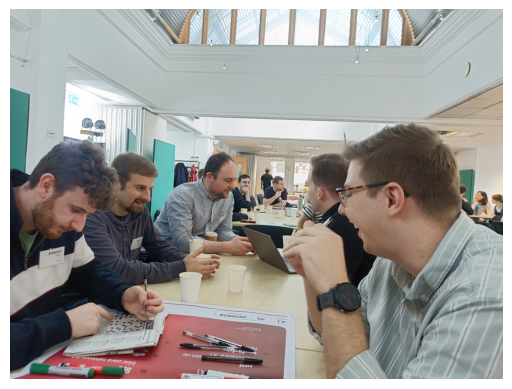

In [611]:
img = Image.open("away_day.jpg")
plt.axis("off")
plt.imshow(img)

### Working out some kinks

Seems to work to give a basic version of what I want currently, but here is a list of problems that I need to work on:

- Rotating: Sometimes the exif orientation of the image is incorrect and needs rotating, how can I catch this automatically?
- Scaling: it doesn't like the scale, in particular it doesn't like portrait images.
- Sampling colours: it sometimes seems to sample the wrong colours at the wrong point, I think this might be fixed by the scaling issue though.
- Output: Currently it just prints a picture, but I'd like it to return a figure so it can be used for processing of a video frame by frame.

Efficiency considerations:

- The sampling of the dots is a bottleneck, but can be done in various more efficient ways. Calling a hash table that has possible samples done already would be more efficient for example.
- What can be done on a GPU?
- Is this the fastest voronoi cell algorithm? It doesn't need to be perfect so a more approximate but faster algorithm could make sense.

Lets start by fixing the scaling thing, going step by step

### Post fixed scaling:

The scaling was fixed by scaling the axes in matplotlib correctly. This however did not result in any other problem being fixed.

### Sampling idea:

I think by applying a different sampling technique for the uniform sampling both the sampling of the colours and some efficiency can be saved. The better sampling algorithm would be something like the following:

1. Get normalised depth mask.
2. Sample a sparse filter matrix for the original pixel aspect, with exactly as many 1's as the depth -> dots function returns.
3. Use the pixel locations as these 

### Efficiency note:

The real bottle neck in this appear to the colouring of the voronoi cells, I wonder how this can be done more efficiently?

- This might require writing my own voronoi cell algorithm that colours the polygons as well, and also bounds the cells around the edges.